# Fully process xenium_ffpe_shapes from xenium_read

18JAN24

In [55]:
import numpy as np
import scanpy as sc
import bento as bt
import matplotlib.pyplot as plt

figdir = "/home/ckmah/d/bento-manuscript/figures/breast_cancer_supp"
sc.settings.figdir = figdir
sc.settings.set_figure_params(vector_friendly=True, dpi=300)

In [3]:
# data directory
adata = bt.io.read_h5ad("Xenium_FFPE_shapes.h5ad")
adata

AnnData object with n_obs × n_vars = 166520 × 541
    obs: 'cell_shape', 'nucleus_shape', 'batch'
    uns: 'points'

### Need array based adata.obsm['spatial]

In [4]:
# could not just use get_coordinates() like in geopandas current version; no way to convert points to just list of (x,y), need to DIY.
adata.obsm["spatial"] = bt.geo.get_shape(adata, "cell_shape").centroid

# convert to array other wise bugs out at filtering

spatial_coordinates = []
for point in adata.obsm["spatial"]:
    spatial_coordinates.append([point.x, point.y])

adata.obsm["spatial"] = np.asarray(spatial_coordinates)

### QC and filter

In [5]:
sc.pp.calculate_qc_metrics(adata, percent_top=(10, 20, 50, 150), inplace=True)

In [6]:
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)

In [7]:
sc.pp.filter_cells(adata, min_counts=10)
sc.pp.filter_genes(adata, min_cells=5)

### Dimensionality reduction

In [8]:
sc.tl.pca(adata, svd_solver="arpack")  # generate PCA features
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)  # compute distances in PCA space
sc.tl.umap(adata)

In [9]:
sc.tl.leiden(adata, key_added="leiden_res1.0", resolution=1.0)

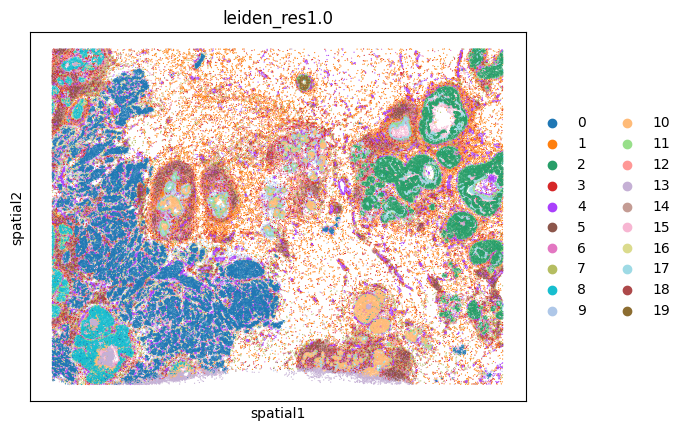

In [10]:
sc.pl.embedding(
    adata,
    basis="spatial",
    color=["leiden_res1.0"],
    wspace=0.25,
    size=3,
)

# Cell typing

Cluster and see what looks most appropriate with per cluster geometry; selecting res 1.0

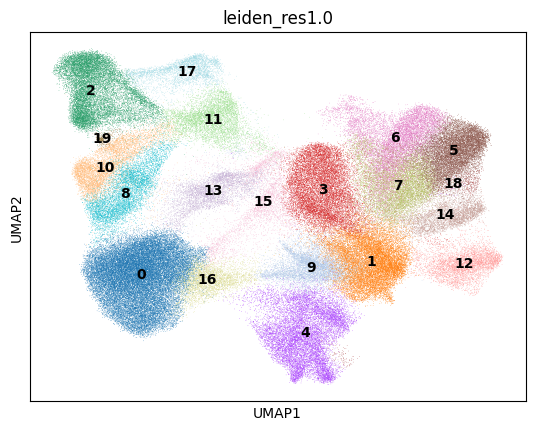

In [11]:
sc.pl.umap(
    adata,
    color=[
        "leiden_res1.0",
    ],
    wspace=0.1,
    legend_loc="on data",
)

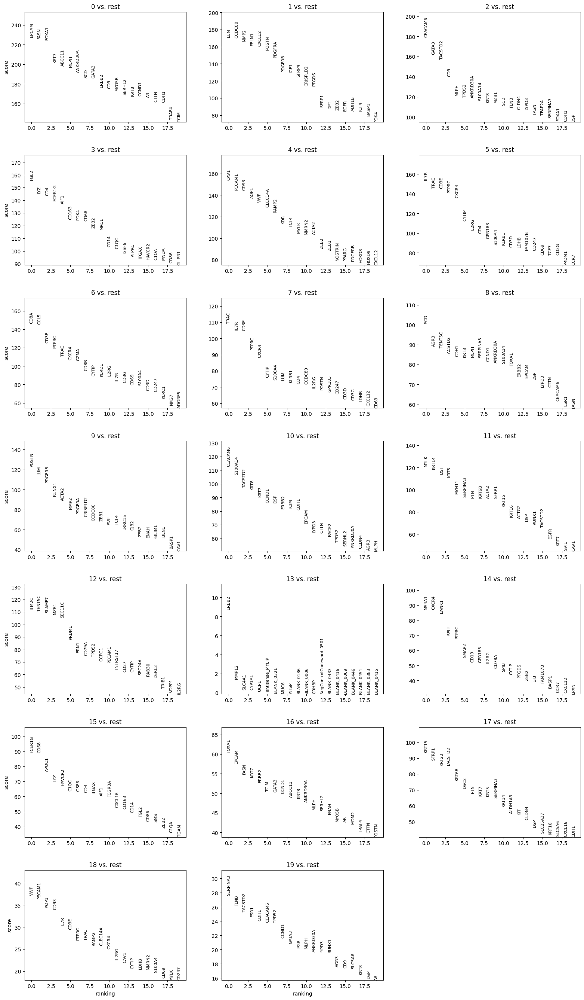

In [12]:
sc.tl.rank_genes_groups(adata, "leiden_res1.0", method="wilcoxon", key_added="wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, ncols=3, key="wilcoxon")

In [13]:
def cell_typing(value):
    celltypes = {
        "0": "invasive tumor",
        "1": "fibroblast",
        "2": "DCIS 1",
        "3": "macrophages",
        "4": "endothelial",
        "5": "CD4+ T cells",
        "6": "CD8+ T cells",
        "7": "CD4+ T cells",
        "8": "DCIS 2",
        "9": "stromal",
        "10": "DCIS 2",
        "11": "myoepithelial ACTA2+",
        "12": "plasma cells",
        "13": "low qc",
        "14": "B cells",
        "15": "TAMs",
        "16": "invasive tumor",
        "17": "myoepithelial KRT15+",
        "18": "low QC",
        "19": "triple positive",
    }
    return celltypes[value]

In [14]:
def cell_typing(value):
    if value == "0":
        return "invasive tumor"
    if value == "1":
        return "fibroblast"
    if value == "2":
        return "DCIS 1"
    if value == "3":
        return "macrophages"
    if value == "4":
        return "endothelial"
    if value == "5":
        return "CD4+ T cells"
    if value == "6":
        return "CD8+ T cells"
    if value == "7":
        return "CD4+ T cells"
    if value == "8":
        return "DCIS 2"
    if value == "9":
        return "stromal"
    if value == "10":
        return "DCIS 2"
    if value == "11":
        return "myoepithelial ACTA2+"
    if value == "12":
        return "plasma cells"
    if value == "13":
        return "low qc"
    if value == "14":
        return "B cells"
    if value == "15":
        return "TAMs"
    if value == "16":
        return "invasive tumor"
    if value == "17":
        return "myoepithelial KRT15+"
    if value == "18":
        return "low QC"
    if value == "19":
        return "triple positive"

In [15]:
# run cell typing
adata.obs["cell_type"] = adata.obs["leiden_res1.0"].map(cell_typing)
adata.obs["cell_type"] = adata.obs["cell_type"].astype("category")

### Rank genes final

In [16]:
sc.tl.dendrogram(adata, "cell_type")
sc.tl.rank_genes_groups(adata, "cell_type")

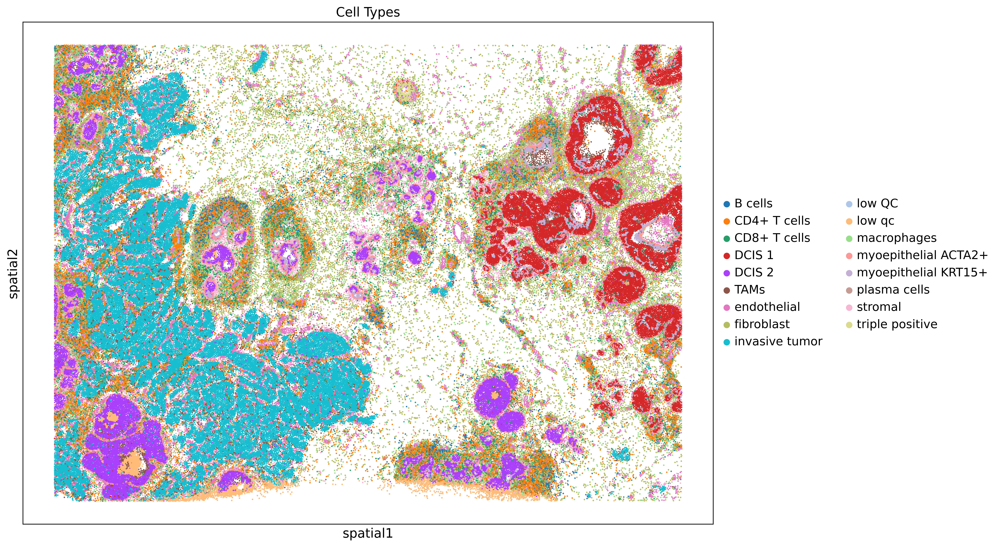

In [73]:
with plt.rc_context({"svg.fonttype": "none", "font.family": "Arial"}):
    fig, ax = plt.subplots(figsize=(20, 10), subplot_kw=dict(aspect="equal"))
    sc.pl.embedding(
        adata,
        color="cell_type",
        basis="spatial",
        # wspace=0.25,
        size=10,
        # groups=["invasive tumor", "DCIS 1", "DCIS 2", "CD8+ T cells"],
        title="Cell Types",
        save="cell_types.svg",
        ax=ax,
    )

[11:53:06] WARNING  findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.    ]8;id=964044;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/font_manager.py\font_manager.py]8;;\:]8;id=375561;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/font_manager.py#1346\1346]8;;\

<Figure size 1200x1200 with 0 Axes>

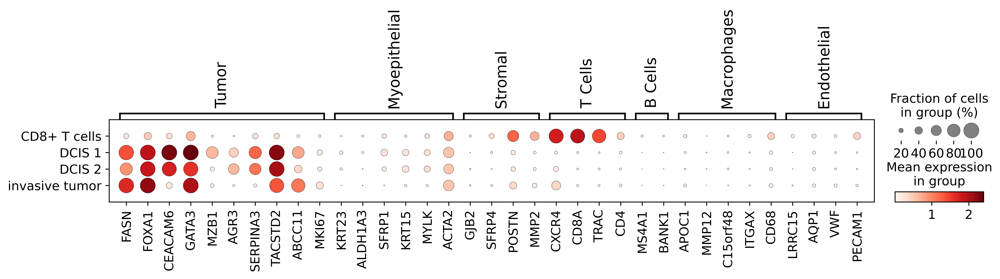

In [74]:
adata_1b = adata[
    adata.obs["cell_type"].isin(["invasive tumor", "DCIS 1", "DCIS 2", "CD8+ T cells"])
]

var_names = {
    "Tumor": [
        "FASN",
        "FOXA1",
        "CEACAM6",
        "GATA3",
        "MZB1",
        "AGR3",
        "SERPINA3",
        "TACSTD2",
        "ABCC11",
        "MKI67",
    ],
    "Myoepithelial": ["KRT23", "ALDH1A3", "SFRP1", "KRT15", "MYLK", "ACTA2"],
    "Stromal": ["GJB2", "SFRP4", "POSTN", "MMP2"],
    "T Cells": ["CXCR4", "CD8A", "TRAC", "CD4"],
    "B Cells": ["MS4A1", "BANK1"],
    "Macrophages": ["APOC1", "MMP12", "C15orf48", "ITGAX", "CD68"],
    "Endothelial": ["LRRC15", "AQP1", "VWF", "PECAM1"],
}

with plt.rc_context({"svg.fonttype": "none", "font.family": "Arial"}):
    fig = plt.figure()
    sc.pl.rank_genes_groups_dotplot(
        adata_1b,
        var_names=var_names,
        dendrogram=False,
        groups=["DCIS 1", "DCIS 2", "invasive tumor", "CD8+ T cells"],
        save=f"cell_type_expression.svg",
    )
    # plt.savefig(
    #     "/home/ckmah/d/bento-manuscript/figures/breast_cancer_supp/cell_type_expression.svg",
    #     dpi=300,
    # )

## Pre Bento Requirements

In [19]:
# # Bento requirements

# adata.uns["points"]["batch"] = 0

# # Cast cell as str for density plot
# adata.uns["points"]["cell"] = adata.uns["points"]["cell"].astype(str)

# # change to cat
# adata.uns["points"]["gene"] = adata.uns["points"]["gene"].astype("category")

In [20]:
# from shapely.geometry import MultiPolygon, Polygon

# adata = adata[
#     ~adata.obs["nucleus_shape"].apply(lambda poly: isinstance(poly, MultiPolygon))
# ]
# adata = adata[
#     ~adata.obs["cell_shape"].apply(lambda poly: isinstance(poly, MultiPolygon))
# ]

# adata.shape

## Subset data per cell type

Generate 1000x1000 size crops each with 770 (greatest common number of cells per 4 crops) and plot. For cells that have >770 cells, take random sample of 770 cells with `random.seed(10)`

In [21]:
# import random
# random.seed(10)

In [22]:
# cell types relevant for analysis

inv_tumor = adata[adata.obs["cell_type"] == "invasive tumor"]
dcis1 = adata[adata.obs["cell_type"] == "DCIS 1"]
dcis2 = adata[adata.obs["cell_type"] == "DCIS 2"]
cd8 = adata[adata.obs["cell_type"] == "CD8+ T cells"]

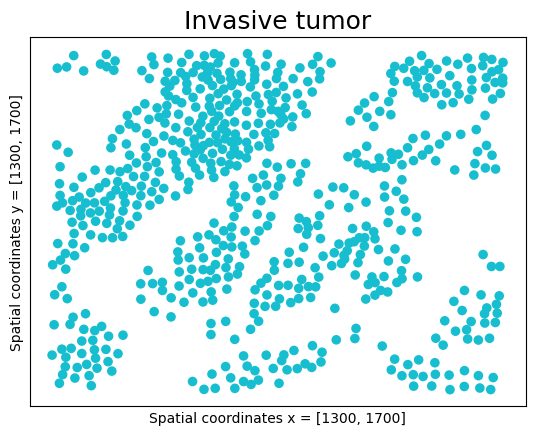

In [23]:
# crops per cell type
inv_tumor_crop = bt.geo.crop(inv_tumor, [1300, 1700], [1300, 1700])
ax = sc.pl.embedding(
    inv_tumor_crop,
    basis="spatial",
    color="cell_type",
    wspace=0.4,
    title="Invasive tumor",
    legend_loc=None,
    show=False,
)
_ = ax.set_xlabel("Spatial coordinates x = [1300, 1700]", fontsize=10)
_ = ax.set_ylabel("Spatial coordinates y = [1300, 1700]", fontsize=10)
_ = ax.title.set_size(18)

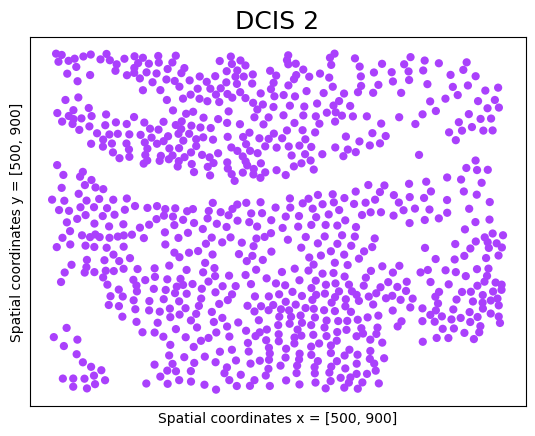

In [24]:
# crops per cell type
dcis2_crop = bt.geo.crop(dcis2, [500, 900], [500, 900])
# dcis2_crop = dcis2_crop[:100]
ax = sc.pl.embedding(
    dcis2_crop,
    basis="spatial",
    color="cell_type",
    wspace=0.4,
    title="DCIS 2",
    legend_loc=None,
    show=False,
)

_ = ax.set_xlabel("Spatial coordinates x = [500, 900]", fontsize=10)
_ = ax.set_ylabel("Spatial coordinates y = [500, 900]", fontsize=10)
_ = ax.title.set_size(18)

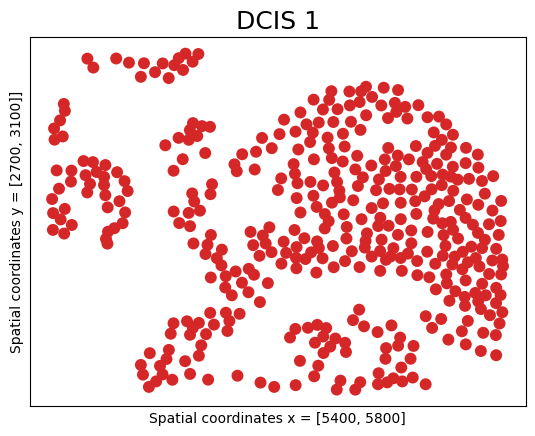

In [25]:
# crops per cell type
dcis1_crop = bt.geo.crop(dcis1, [5400, 5800], [2700, 3100])
# dcis1_crop = dcis1_crop[random.sample(range(0, len(dcis1_crop)), 770)]
ax = sc.pl.embedding(
    dcis1_crop,
    basis="spatial",
    color="cell_type",
    wspace=0.4,
    title="DCIS 1",
    legend_loc=None,
    show=False,
)

_ = ax.set_xlabel("Spatial coordinates x = [5400, 5800]", fontsize=10)
_ = ax.set_ylabel("Spatial coordinates y = [2700, 3100]]", fontsize=10)
_ = ax.title.set_size(18)

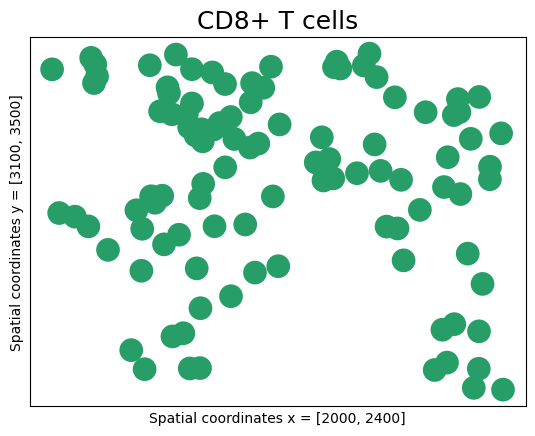

In [26]:
# crops per cell type
cd8_crop = bt.geo.crop(cd8, [2000, 2400], [3100, 3500])
ax = sc.pl.embedding(
    cd8_crop,
    basis="spatial",
    color="cell_type",
    wspace=0.4,
    title="CD8+ T cells",
    legend_loc=None,
    show=False,
)

_ = ax.set_xlabel("Spatial coordinates x = [2000, 2400]", fontsize=10)
_ = ax.set_ylabel("Spatial coordinates y = [3100, 3500]", fontsize=10)
_ = ax.title.set_size(18)

# Run Bento

In [27]:
def get_geometries(adata):
    bt.tl.obs_stats(adata)
    bt.tl.analyze_shapes(
        adata,
        ["cell_shape", "nucleus_shape"],
        ["radius", "aspect_ratio", "area", "density"],
    )
    bt.pl.obs_stats(
        adata,
        obs_cols=[
            "cell_radius",
            "cell_aspect_ratio",
            "cell_area",
            "cell_density",
            "nucleus_radius",
            "nucleus_aspect_ratio",
            "nucleus_area",
            "nucleus_density",
        ],
    )

    return adata

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

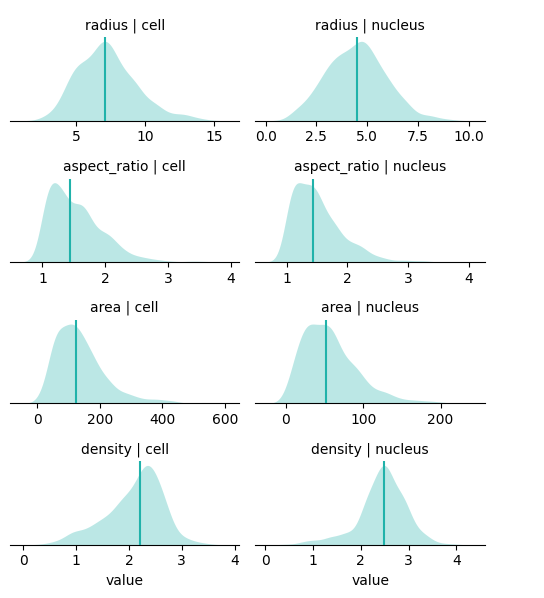

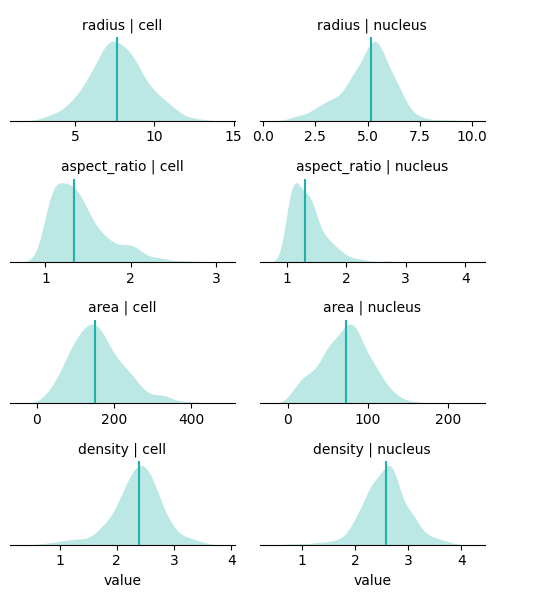

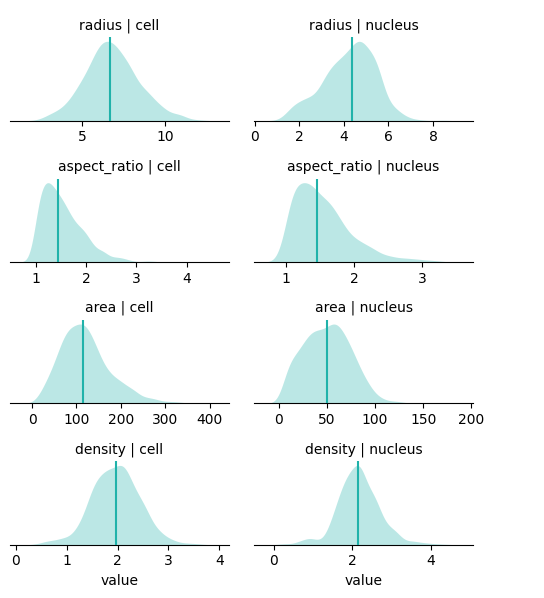

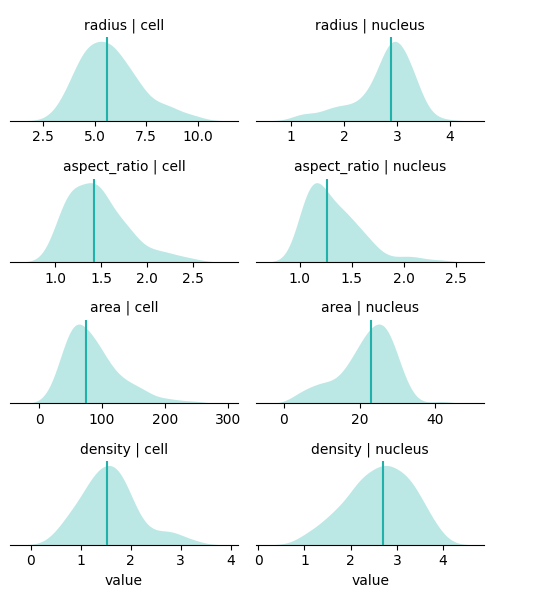

In [28]:
datasets = [inv_tumor_crop, dcis1_crop, dcis2_crop, cd8_crop]
for sample in datasets:
    get_geometries(sample)

In [29]:
def rnaFlux(adata):
    res = 1
    mean_radius = adata.obs["cell_radius"].mean()
    bt.tl.flux(adata, radius=mean_radius / 2, res=res)
    # bt.pl.flux(adata, res=res)

In [30]:
datasets = [inv_tumor_crop, dcis1_crop, dcis2_crop, cd8_crop]
for sample in datasets:
    rnaFlux(sample)

  0%|          | 0/626 [00:00<?, ?it/s]

  0%|          | 0/406 [00:00<?, ?it/s]

  0%|          | 0/855 [00:00<?, ?it/s]

  0%|          | 0/103 [00:00<?, ?it/s]

In [31]:
flux_params = dict(res=1, alpha=True, dx=0.2125)

In [32]:
# # delete cell raster for write.h5ad

# del inv_tumor_crop.obs["cell_raster"]
# del dcis1_crop.obs["cell_raster"]
# del dcis2_crop.obs["cell_raster"]
# del cd8_crop.obs["cell_raster"]

In [33]:
# bt.io.write_h5ad(inv_tumor_crop, "inv_tumor_crop_flux.h5ad")
# bt.io.write_h5ad(dcis1_crop, "dcis1_crop_flux.h5ad")
# bt.io.write_h5ad(dcis2_crop, "dcis2_crop_flux.h5ad")
# bt.io.write_h5ad(cd8_crop, "cd8_crop_flux.h5ad")

Text(0.5, 1.0, 'Inv Tumor')

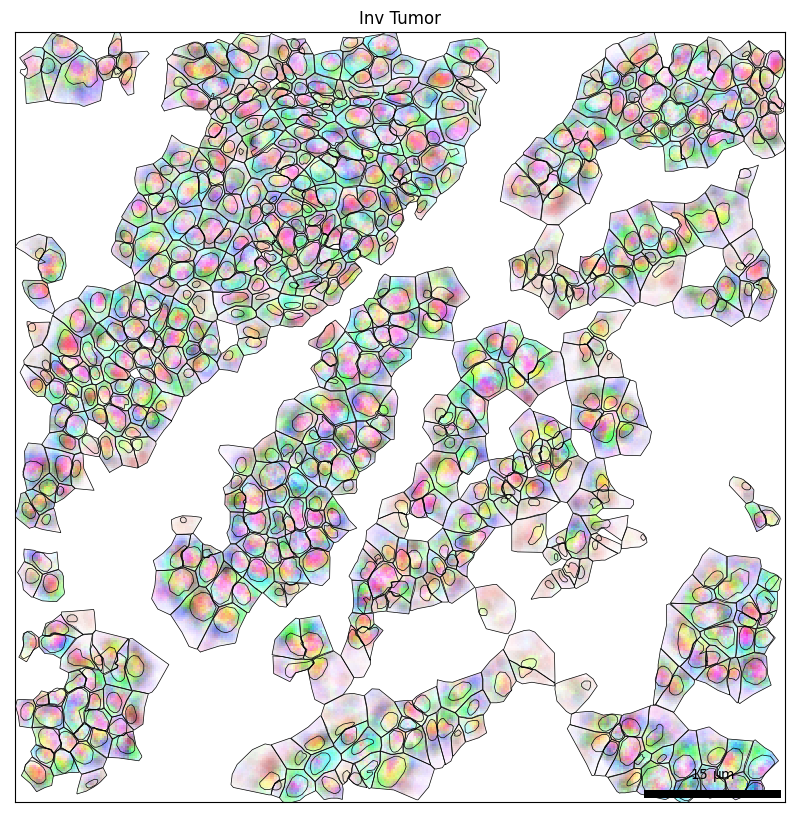

In [34]:
plt.figure(figsize=(10, 10))
bt.pl.flux(inv_tumor_crop, **flux_params)
plt.title("Inv Tumor")

In [35]:
i = [x for x in random.choices(range(len(inv_tumor_crop)), k=20)]
fig, axes = plt.subplots(4, 5, figsize=(10, 8))
for i, ax in zip(i, axes.flat):
    bt.pl.flux(inv_tumor_crop[i], ax=ax, square=True, title=" ", **flux_params)

plt.title("Individual cells")
plt.subplots_adjust(wspace=0.1, hspace=0.1)

NameError: name 'random' is not defined

Text(0.5, 1.0, 'DCIS 1')

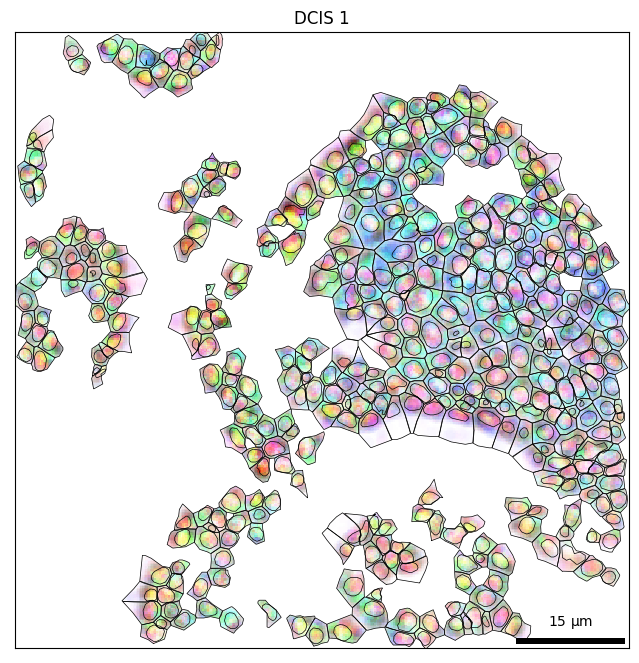

In [ ]:
plt.figure(figsize=(8, 8))
bt.pl.flux(dcis1_crop, **flux_params)
plt.title("DCIS 1")

Text(0.5, 1.0, 'Individual cells')

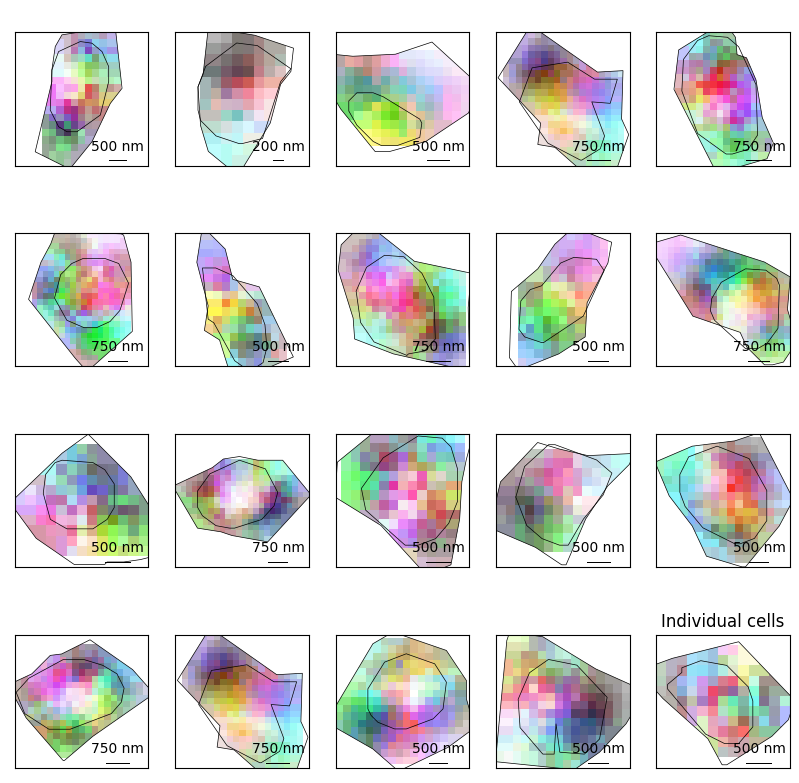

In [ ]:
i = [x for x in random.choices(range(len(dcis1_crop)), k=20)]
fig, axes = plt.subplots(4, 5, figsize=(10, 10))
for i, ax in zip(i, axes.flat):
    bt.pl.flux(dcis1_crop[i], ax=ax, square=True, title=" ", **flux_params)

plt.title("Individual cells")

Text(0.5, 1.0, 'DCIS 2')

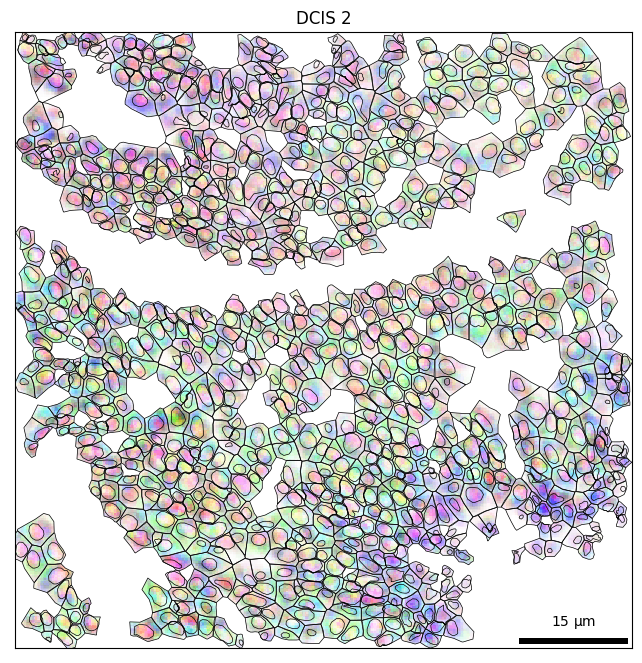

In [ ]:
plt.figure(figsize=(8, 8))
bt.pl.flux(dcis2_crop, **flux_params)
plt.title("DCIS 2")

Text(0.5, 1.0, 'Individual cells')

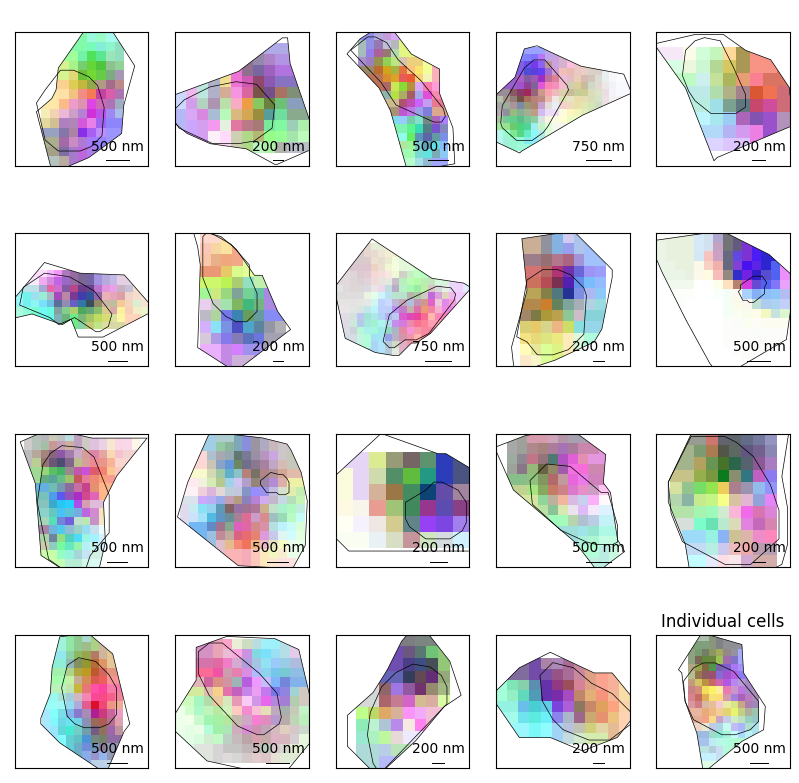

In [ ]:
i = [x for x in random.choices(range(len(dcis2_crop)), k=20)]
fig, axes = plt.subplots(4, 5, figsize=(10, 10))
for i, ax in zip(i, axes.flat):
    bt.pl.flux(dcis2_crop[i], ax=ax, square=True, title=" ", **flux_params)

plt.title("Individual cells")

Text(0.5, 1.0, 'CD8+ T cells')

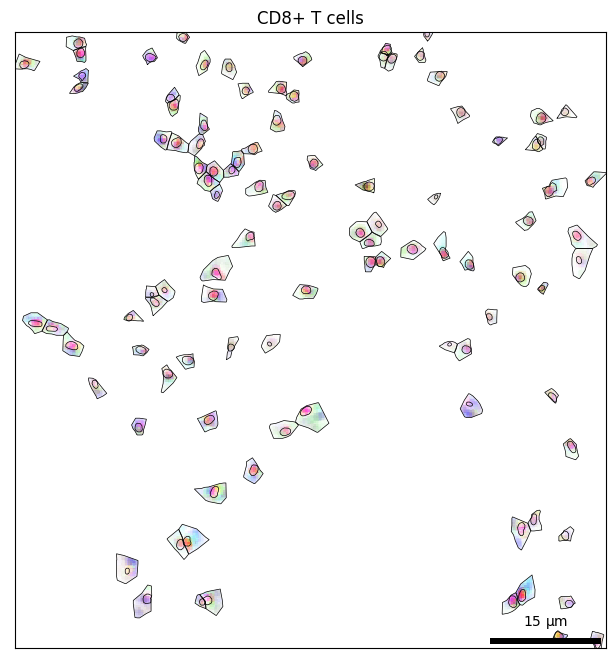

In [ ]:
plt.figure(figsize=(8, 8))
bt.pl.flux(cd8_crop, **flux_params)
plt.title("CD8+ T cells")

Text(0.5, 1.0, 'Individual cells')

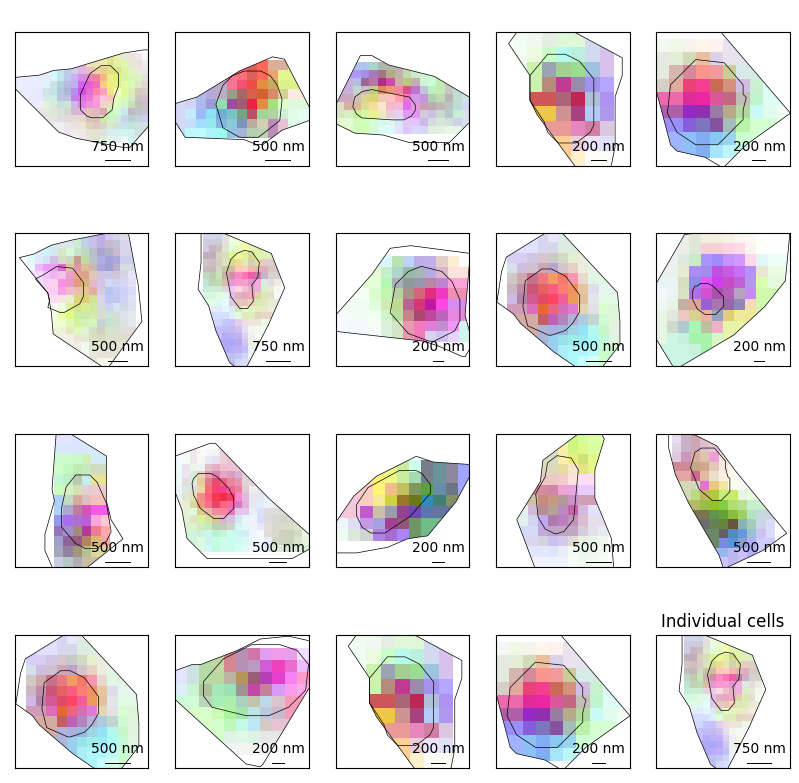

In [ ]:
i = [x for x in random.choices(range(len(cd8_crop)), k=20)]
fig, axes = plt.subplots(4, 5, figsize=(10, 10))
for i, ax in zip(i, axes.flat):
    bt.pl.flux(cd8_crop[i], ax=ax, square=True, title=" ", **flux_params)

plt.title("Individual cells")

In [ ]:
res = 1

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

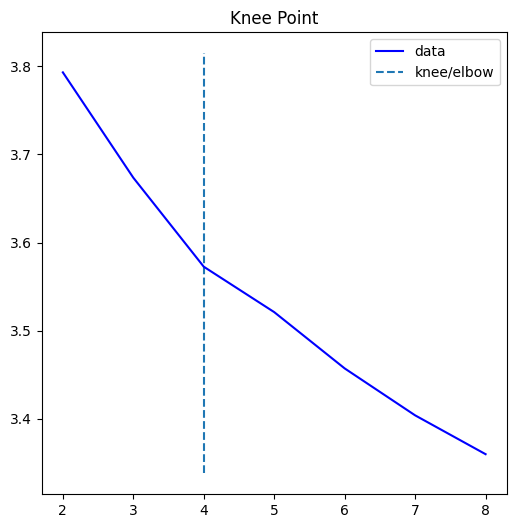

  0%|          | 0/626 [00:00<?, ?it/s]

  0%|          | 0/626 [00:00<?, ?it/s]

In [ ]:
# datasets = [inv_tumor_crop, dcis1_crop, dcis2_crop, cd8_crop]

# tumorinv
bt.tl.fluxmap(datasets[0], res=res)

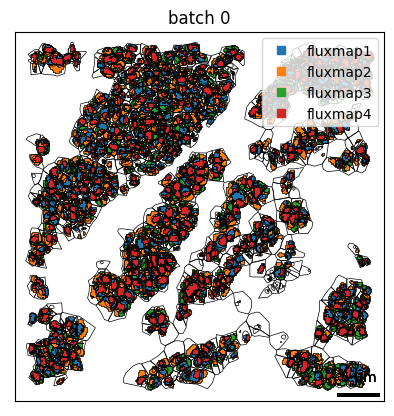

In [ ]:
bt.pl.fluxmap(datasets[0])

In [ ]:
def scFluxmap20(adata):
    i = [x for x in random.choices(range(len(adata)), k=16)]
    fig, axes = plt.subplots(4, 4, figsize=(10, 10))
    for i, ax in zip(i, axes.flat):
        bt.pl.fluxmap(adata[i], ax=ax, legend=None, square=True)
        ax.set_title(" ")

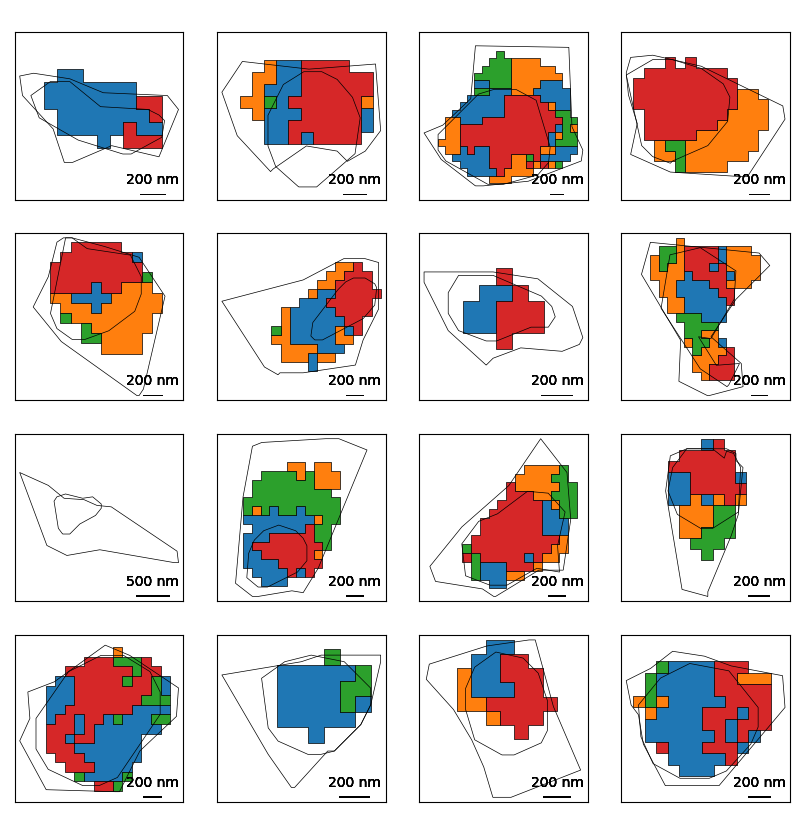

In [ ]:
scFluxmap20(inv_tumor_crop)

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

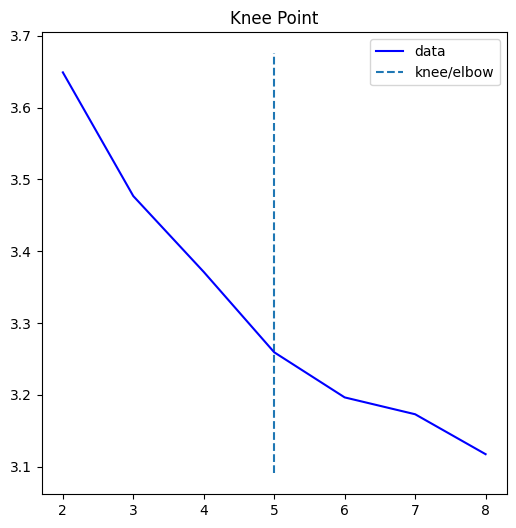

  0%|          | 0/406 [00:00<?, ?it/s]

  0%|          | 0/406 [00:00<?, ?it/s]

In [ ]:
bt.tl.fluxmap(dcis1_crop, res=res)

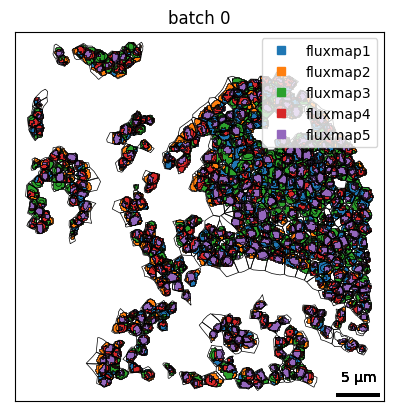

In [ ]:
bt.pl.fluxmap(dcis1_crop)

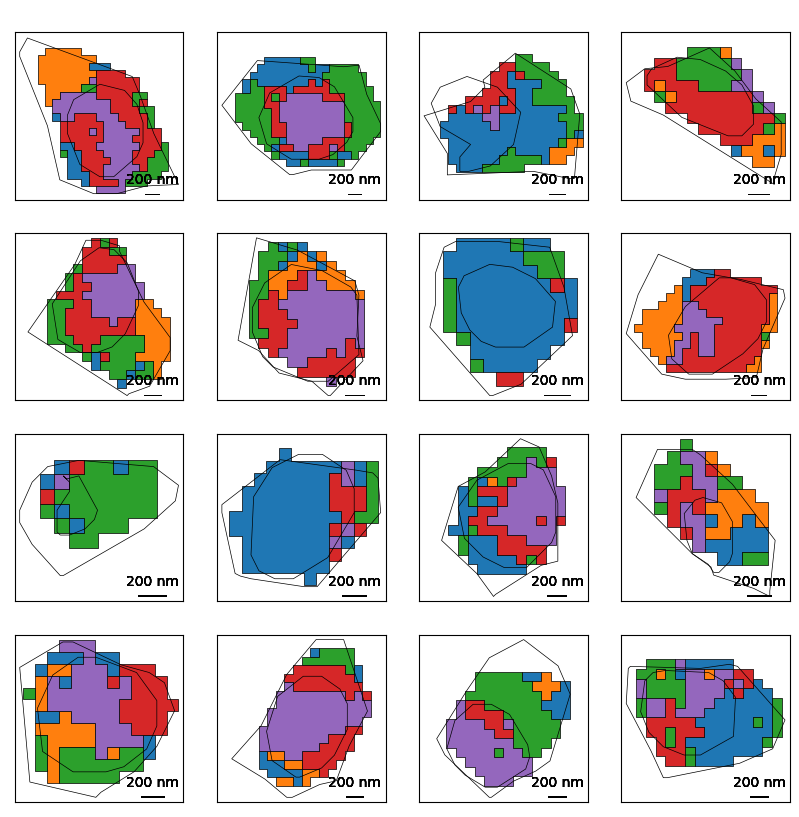

In [ ]:
scFluxmap20(dcis1_crop)

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

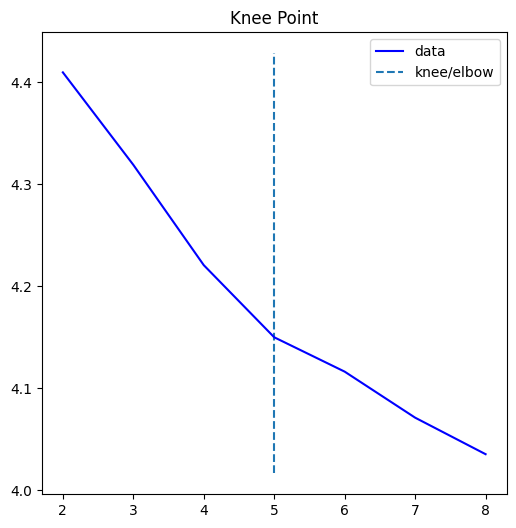

  0%|          | 0/855 [00:00<?, ?it/s]

  0%|          | 0/855 [00:00<?, ?it/s]

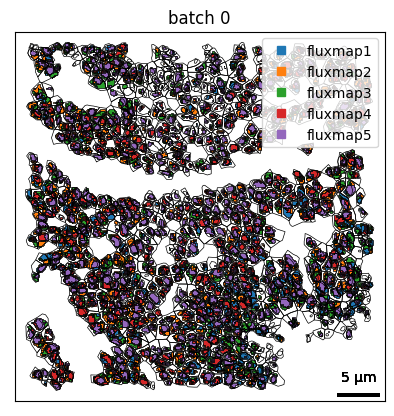

In [ ]:
bt.tl.fluxmap(dcis2_crop, res=res)
bt.pl.fluxmap(dcis2_crop)

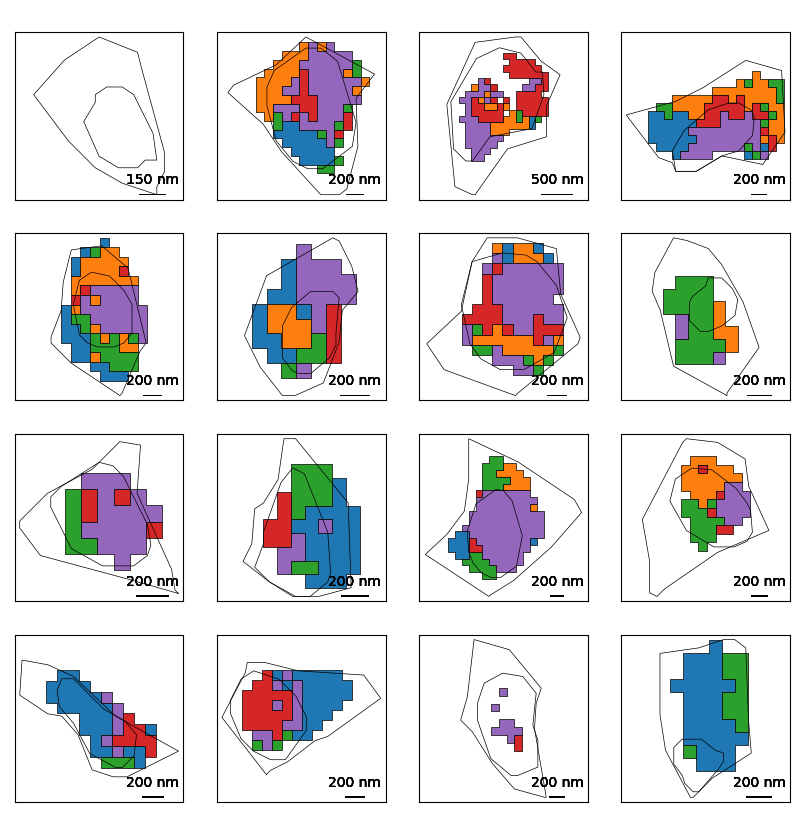

In [ ]:
scFluxmap20(dcis2_crop)

In [ ]:
bt.tl.fluxmap(cd8_crop, res=res)

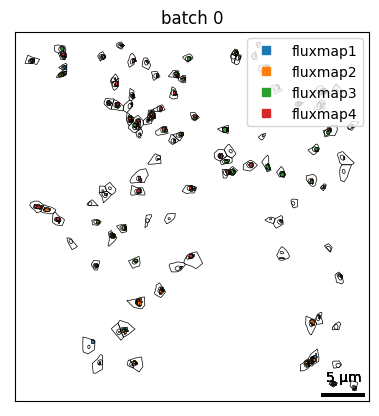

In [ ]:
bt.pl.fluxmap(cd8_crop)

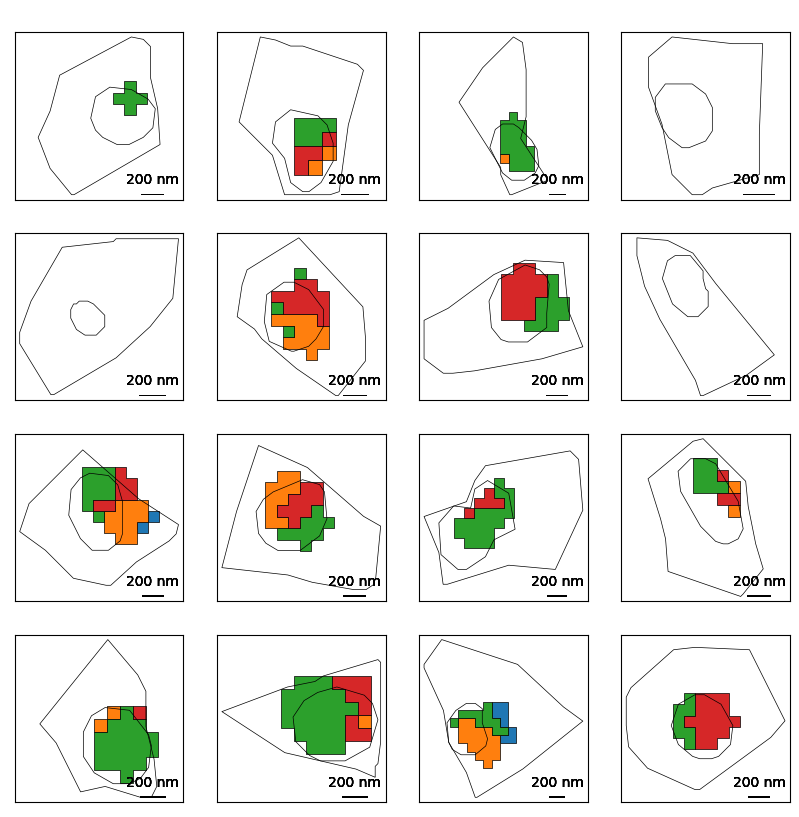

In [ ]:
scFluxmap20(cd8_crop)

### Bento Localization patterns

In [ ]:
for sample in datasets:
    bt.tl.lp(sample)

Crunching shape features...
Crunching point features...
Saving results...
Done.
Crunching shape features...
Crunching point features...
Saving results...
Done.
Crunching shape features...
Crunching point features...
Saving results...
Done.
Crunching shape features...
Crunching point features...
Saving results...
Done.
Crunching shape features...
Crunching point features...
Saving results...
Done.
Crunching shape features...
Crunching point features...
Saving results...
Done.
Crunching shape features...
Crunching point features...
Saving results...
Done.
Crunching shape features...
Crunching point features...
Saving results...
Done.


In [ ]:
bt.tl.lp(dcis2_crop)

Crunching shape features...
Crunching point features...
Saving results...
Done.
Crunching shape features...
Crunching point features...
Saving results...
Done.


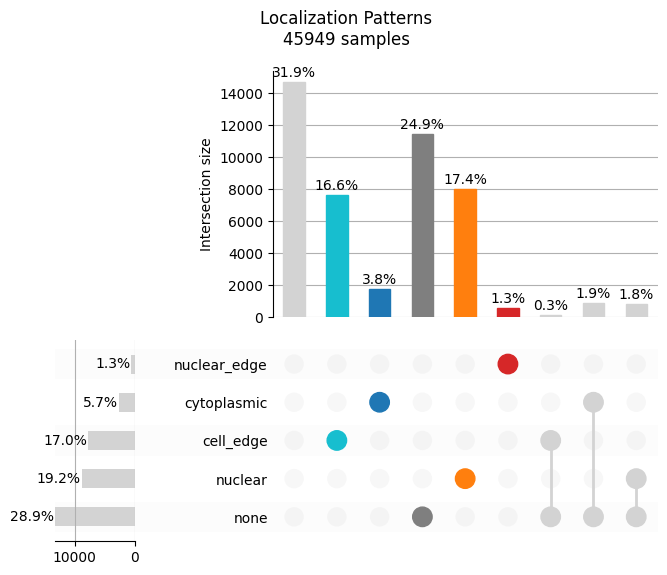

In [ ]:
bt.pl.lp_dist(inv_tumor_crop, percentage=True)

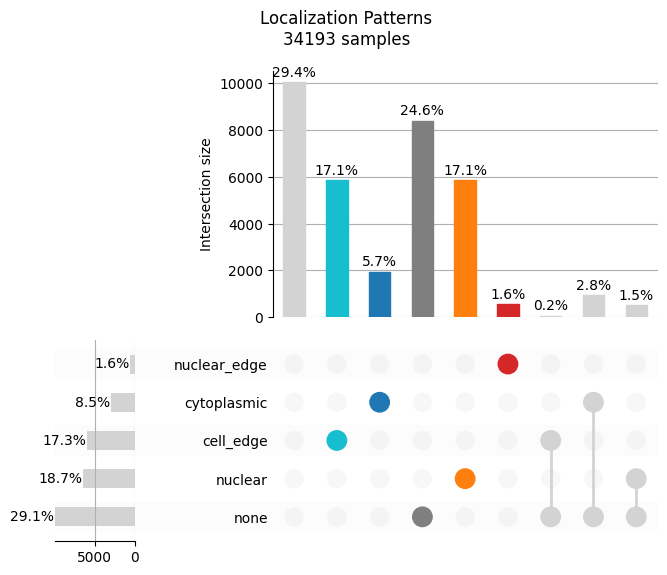

In [ ]:
bt.pl.lp_dist(dcis1_crop, percentage=True)

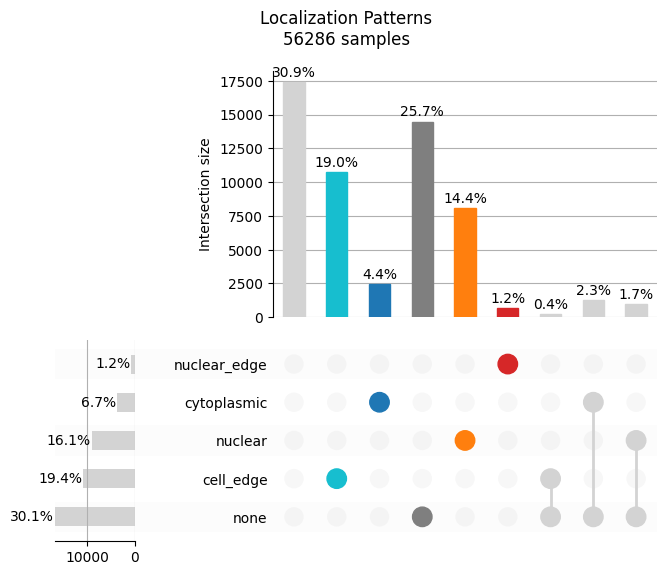

In [ ]:
bt.pl.lp_dist(dcis2_crop, percentage=True)

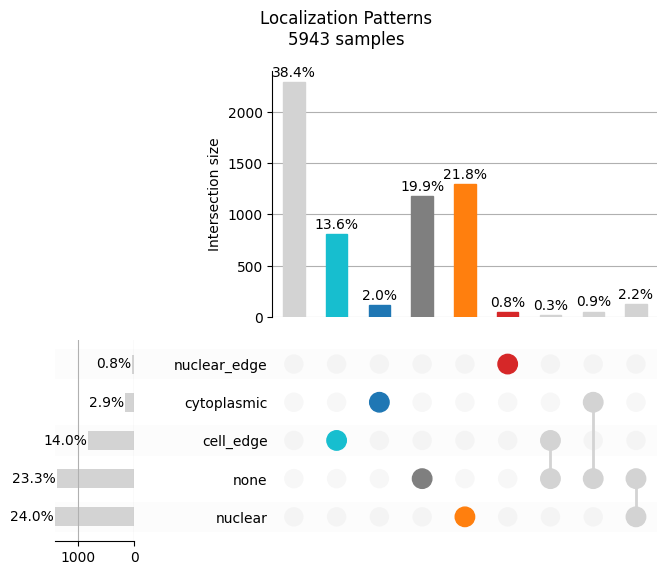

In [ ]:
bt.pl.lp_dist(cd8_crop, percentage=True)

### Functional enrichment of fluxmaps

Apex seq data comparison

In [ ]:
a = np.asarray(inv_tumor_crop.uns["flux"].todense()
#inv_tumor_crop.obs["flux"] = a

ValueError: Length of values (86952) does not match length of index (626)

In [ ]:
bt.tl.fe_fazal2019(inv_tumor_crop)

ValueError: setting an array element with a sequence.